In [ ]:
import pandas as pd
import numpy as np
from datetime import timedelta

import matplotlib.pyplot as plt

from sklearn.metrics.pairwise import cosine_similarity
from collections import defaultdic

LOADING THE DATASETS

In [41]:
# Loading the dataset
df_events = pd.read_csv('/Users/treva.ogwang/Desktop/Codes/dataset/archive_1/events.csv')
df_events

,timestamp,visitorid,event,itemid,transactionid
0,1433221332117,257597,view,355908,NaN
1,1433224214164,992329,view,248676,NaN
2,1433221999827,111016,view,318965,NaN
3,1433221955914,483717,view,253185,NaN
4,1433221337106,951259,view,367447,NaN
...,...,...,...,...,...
2756096,1438398785939,591435,view,261427,NaN
2756097,1438399813142,762376,view,115946,NaN
2756098,1438397820527,1251746,view,78144,NaN
2756099,1438398530703,1184451,view,283392,NaN


In [42]:
#Converting the timestamp column to datetime
df_events['timestamp'] = pd.to_datetime(df_events['timestamp'], unit='ms')
df_events.head()

,timestamp,visitorid,event,itemid,transactionid
0,2015-06-02 05:02:12.117,257597,view,355908,NaN
1,2015-06-02 05:50:14.164,992329,view,248676,NaN
2,2015-06-02 05:13:19.827,111016,view,318965,NaN
3,2015-06-02 05:12:35.914,483717,view,253185,NaN
4,2015-06-02 05:02:17.106,951259,view,367447,NaN


In [43]:
# Loading the dataset
df_category_tree = pd.read_csv('/Users/treva.ogwang/Desktop/Codes/dataset/archive_1/category_tree.csv')
df_category_tree

,categoryid,parentid
0,1016,213.0
1,809,169.0
2,570,9.0
3,1691,885.0
4,536,1691.0
...,...,...
1664,49,1125.0
1665,1112,630.0
1666,1336,745.0
1667,689,207.0


In [44]:
# Loading the dataset
item_props1 = pd.read_csv('/Users/treva.ogwang/Desktop/Codes/dataset/archive_1/item_properties_part1.csv')
item_props2 = pd.read_csv('/Users/treva.ogwang/Desktop/Codes/dataset/archive_1/item_properties_part2.csv')
df_item_properties = pd.concat([item_props1, item_props2], ignore_index=True)
df_item_properties

,timestamp,itemid,property,value
0,1435460400000,460429,categoryid,1338
1,1441508400000,206783,888,1116713 960601 n277.200
2,1439089200000,395014,400,n552.000 639502 n720.000 424566
3,1431226800000,59481,790,n15360.000
4,1431831600000,156781,917,828513
...,...,...,...,...
20275897,1433646000000,236931,929,n12.000
20275898,1440903600000,455746,6,150169 639134
20275899,1439694000000,347565,686,610834
20275900,1433646000000,287231,867,769062


In [45]:
df_item_properties.iloc[5]

timestamp    1436065200000
itemid              285026
property         available
value                    0
Name: 5, dtype: object

In [46]:
# Convertimng the timestamp column to datetime
df_item_properties['timestamp'] = pd.to_datetime(df_events['timestamp'], unit='ms')
df_item_properties.head()

,timestamp,itemid,property,value
0,2015-06-02 05:02:12.117,460429,categoryid,1338
1,2015-06-02 05:50:14.164,206783,888,1116713 960601 n277.200
2,2015-06-02 05:13:19.827,395014,400,n552.000 639502 n720.000 424566
3,2015-06-02 05:12:35.914,59481,790,n15360.000
4,2015-06-02 05:02:17.106,156781,917,828513


EXPLORATORY DATA ANALYSIS

In [47]:
# Checking for missing values in the events df
df_events.isnull().sum()

timestamp              0
visitorid              0
event                  0
itemid                 0
transactionid    2733644
dtype: int64

In [48]:
# Checking for the shape in the events df
df_events.shape

(2756101, 5)

In [49]:
# Checking for unique values in the events df
df_events['event'].value_counts()

event
view           2664312
addtocart        69332
transaction      22457
Name: count, dtype: int64

In [50]:
#Checking for unique visitors in the events df
df_events['visitorid'].unique()

array([ 257597,  992329,  111016, ...,  591435,  762376, 1184451])

In [51]:
# Checking for unique items in the events df
df_events['itemid'].unique()

array([355908, 248676, 318965, ...,    613,  52086, 177353])

In [52]:
#Checking what one user purchased
user1 = df_events['visitorid'].iloc[0]
df_events[df_events['visitorid'] == user1]

,timestamp,visitorid,event,itemid,transactionid
0,2015-06-02 05:02:12.117,257597,view,355908,NaN
152610,2015-06-08 22:00:21.247,257597,view,302696,NaN


DATA PREPROCESSING

In [53]:
#Filtering the events df for purchases or items that were added to the cart because we are interested in these two events
df_filtered = df_events[df_events['event'].isin(['addtocart', 'transaction'])].copy()
df_filtered

,timestamp,visitorid,event,itemid,transactionid
17,2015-06-02 05:33:56.124,287857,addtocart,5206,NaN
19,2015-06-02 04:57:58.505,158090,addtocart,10572,NaN
63,2015-06-02 05:39:03.021,1193904,addtocart,255275,NaN
112,2015-06-02 05:12:21.632,599528,addtocart,356475,NaN
130,2015-06-02 05:17:56.276,599528,transaction,356475,4000.0
...,...,...,...,...,...
2755956,2015-08-01 03:40:00.805,831605,addtocart,57810,NaN
2756056,2015-08-01 03:02:36.086,10670,addtocart,419736,NaN
2756074,2015-08-01 03:49:54.744,144106,addtocart,141241,NaN
2756078,2015-08-01 03:30:07.937,804736,addtocart,447661,NaN


In [54]:
# Filtering using visitor + time
df_filtered.sort_values(by=['visitorid', 'timestamp'], inplace=True)
df_filtered

,timestamp,visitorid,event,itemid,transactionid
1133190,2015-08-30 06:03:48.202,6,addtocart,65273,NaN
138668,2015-06-07 23:30:18.230,150,addtocart,452955,NaN
1361435,2015-09-11 06:12:12.678,155,addtocart,368372,NaN
1357916,2015-09-11 06:12:17.583,155,addtocart,452082,NaN
1368056,2015-09-11 06:12:47.871,155,addtocart,181405,NaN
...,...,...,...,...,...
2024081,2015-05-30 02:39:48.975,1407512,addtocart,290723,NaN
2023974,2015-05-30 02:49:56.910,1407512,addtocart,398091,NaN
2009117,2015-05-30 02:50:47.297,1407512,addtocart,241408,NaN
2022592,2015-05-30 02:51:21.393,1407512,addtocart,398533,NaN


In [55]:
# Creating Session ID
# Setting the time threshold for session creation

session_threshold = timedelta(minutes=10)

# Initializing the session ID tracker
df_filtered['session_id'] = 0

# Grouping by user
current_session_id = 0

for visitorid, group in df_filtered.groupby('visitorid'):
    previous_time = None
    for index, row in group.iterrows():
        if previous_time is None or (row['timestamp'] - previous_time) > session_threshold:
            current_session_id += 1
        df_filtered.at[index, 'session_id'] = current_session_id
        previous_time = row['timestamp']
    
df_filtered

,timestamp,visitorid,event,itemid,transactionid,session_id
1133190,2015-08-30 06:03:48.202,6,addtocart,65273,NaN,1
138668,2015-06-07 23:30:18.230,150,addtocart,452955,NaN,2
1361435,2015-09-11 06:12:12.678,155,addtocart,368372,NaN,3
1357916,2015-09-11 06:12:17.583,155,addtocart,452082,NaN,3
1368056,2015-09-11 06:12:47.871,155,addtocart,181405,NaN,3
...,...,...,...,...,...,...
2024081,2015-05-30 02:39:48.975,1407512,addtocart,290723,NaN,53347
2023974,2015-05-30 02:49:56.910,1407512,addtocart,398091,NaN,53348
2009117,2015-05-30 02:50:47.297,1407512,addtocart,241408,NaN,53348
2022592,2015-05-30 02:51:21.393,1407512,addtocart,398533,NaN,53348


In [56]:
user_event_counts = df_filtered['visitorid'].value_counts()

user_event_counts.describe()

count    38865.000000
mean         2.361739
std         11.465854
min          1.000000
25%          1.000000
50%          1.000000
75%          2.000000
max       1278.000000
Name: count, dtype: float64

In [57]:
# Removing abnormal users who are likely to be bots
abnormal_users = user_event_counts[user_event_counts > 50].index

# Filter them out
df_filtered = df_filtered[~df_filtered['visitorid'].isin(abnormal_users)]
df_filtered

,timestamp,visitorid,event,itemid,transactionid,session_id
1133190,2015-08-30 06:03:48.202,6,addtocart,65273,NaN,1
138668,2015-06-07 23:30:18.230,150,addtocart,452955,NaN,2
1361435,2015-09-11 06:12:12.678,155,addtocart,368372,NaN,3
1357916,2015-09-11 06:12:17.583,155,addtocart,452082,NaN,3
1368056,2015-09-11 06:12:47.871,155,addtocart,181405,NaN,3
...,...,...,...,...,...,...
2024081,2015-05-30 02:39:48.975,1407512,addtocart,290723,NaN,53347
2023974,2015-05-30 02:49:56.910,1407512,addtocart,398091,NaN,53348
2009117,2015-05-30 02:50:47.297,1407512,addtocart,241408,NaN,53348
2022592,2015-05-30 02:51:21.393,1407512,addtocart,398533,NaN,53348


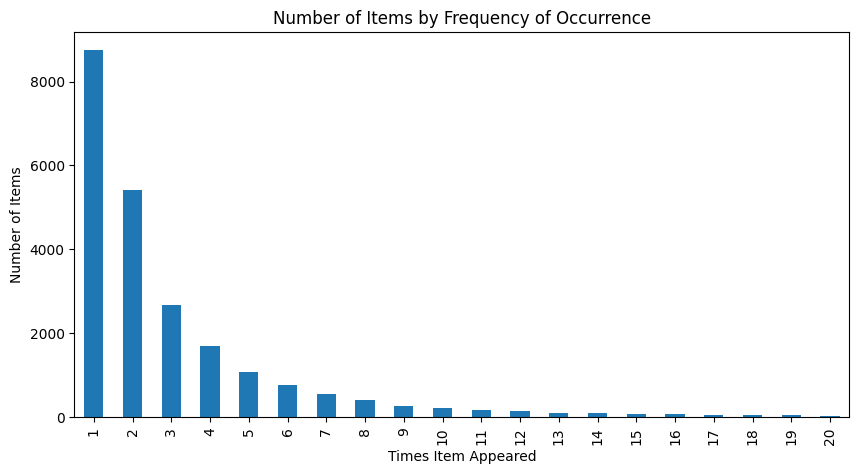

In [58]:
item_counts = df_filtered['itemid'].value_counts()

plt.figure(figsize=(10,5))
item_counts.value_counts().sort_index().head(20).plot(kind='bar')
plt.title("Number of Items by Frequency of Occurrence")
plt.xlabel("Times Item Appeared")
plt.ylabel("Number of Items")
plt.show()

In [59]:
# Removing items that are seen only once
valid_items = item_counts[item_counts > 1].index

df_filtered = df_filtered[df_filtered['itemid'].isin(valid_items)]
df_filtered

,timestamp,visitorid,event,itemid,transactionid,session_id
1133190,2015-08-30 06:03:48.202,6,addtocart,65273,NaN,1
138668,2015-06-07 23:30:18.230,150,addtocart,452955,NaN,2
1366578,2015-09-12 04:38:00.026,155,addtocart,389974,NaN,4
848067,2015-08-15 00:50:16.912,172,addtocart,10034,NaN,5
861350,2015-08-15 01:13:39.691,172,addtocart,465522,NaN,6
...,...,...,...,...,...,...
466922,2015-06-23 22:22:47.672,1407437,addtocart,389814,NaN,53345
2013483,2015-05-30 02:19:43.859,1407512,addtocart,107832,NaN,53346
2024092,2015-05-30 02:32:56.327,1407512,addtocart,326819,NaN,53347
2024081,2015-05-30 02:39:48.975,1407512,addtocart,290723,NaN,53347


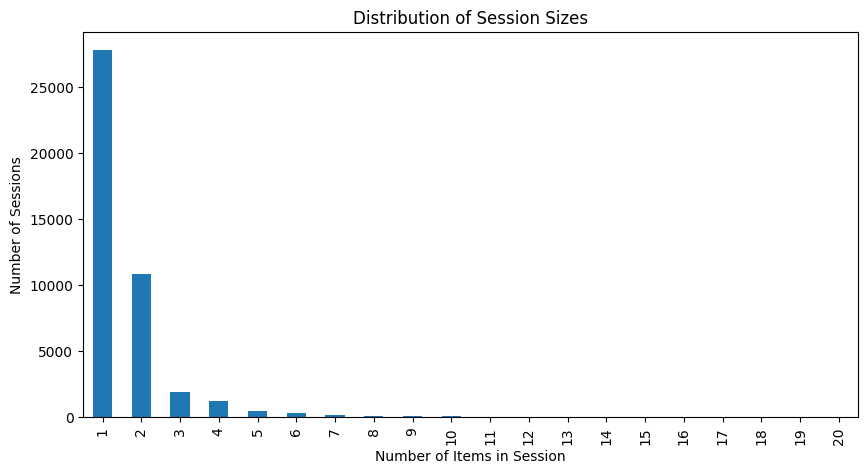

In [60]:
session_item_counts = df_filtered.groupby('session_id')['itemid'].count()

plt.figure(figsize=(10,5))
session_item_counts.value_counts().sort_index().head(20).plot(kind='bar')
plt.title("Distribution of Session Sizes")
plt.xlabel("Number of Items in Session")
plt.ylabel("Number of Sessions")
plt.show()

In [61]:
#Keeping sessions with more than 1 item
valid_sessions = session_item_counts[session_item_counts > 1].index

df_filtered = df_filtered[df_filtered['session_id'].isin(valid_sessions)]
df_filtered

,timestamp,visitorid,event,itemid,transactionid,session_id
861350,2015-08-15 01:13:39.691,172,addtocart,465522,NaN,6
856379,2015-08-15 01:13:48.324,172,addtocart,465522,NaN,6
848114,2015-08-15 01:29:01.230,172,transaction,465522,9725.0,7
850895,2015-08-15 01:29:01.686,172,transaction,10034,9725.0,7
811557,2015-08-12 16:28:16.523,186,addtocart,49029,NaN,9
...,...,...,...,...,...,...
1773812,2015-05-18 22:28:21.266,1406981,transaction,436004,686.0,53329
667959,2015-08-04 23:05:35.724,1407110,addtocart,360922,NaN,53338
677835,2015-08-04 23:11:25.624,1407110,transaction,360922,3851.0,53338
2024092,2015-05-30 02:32:56.327,1407512,addtocart,326819,NaN,53347


In [62]:
# Creating a pivot table
session_item_matrix = pd.crosstab(df_filtered['session_id'], df_filtered['itemid'])
session_item_matrix

itemid,15,19,25,33,42,147,199,212,304,315,...,466319,466321,466385,466443,466526,466614,466710,466844,466861,466864
session_id,,,,,,,,,,,,,,,,,,,,,
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
10,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
19,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53319,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
53321,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
53329,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [63]:
# Transposing the matrix
item_session_matrix = session_item_matrix.T
item_session_matrix

session_id,6,7,9,10,19,21,27,28,32,33,...,53301,53302,53312,53315,53318,53319,53321,53329,53338,53347
itemid,,,,,,,,,,,,,,,,,,,,,
15,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
19,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
25,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
33,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
42,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466614,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
466710,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
466844,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [64]:
# Computing the cosine similarity
item_similarity = cosine_similarity(item_session_matrix)

# Creating a DataFrame for the similarity matrix
item_similarity_df = pd.DataFrame(
    item_similarity,
    index = item_session_matrix.index,
    columns = item_session_matrix.index
)

item_similarity_df

itemid,15,19,25,33,42,147,199,212,304,315,...,466319,466321,466385,466443,466526,466614,466710,466844,466861,466864
itemid,,,,,,,,,,,,,,,,,,,,,
15,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
19,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
33,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
42,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466614,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
466710,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
466844,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [65]:
''' Using a threshold to only display items with cosine similarity of 0.80 or higher.
def recommend_items(item_id, top_n=5, threshold=0.75):
    if item_id not in item_similarity_df.index:
        return f"Item {item_id} not found in the similarity matrix."
    
    similarities = item_similarity_df.loc[item_id]

    # Filter out itself and low scores
    filtered = similarities[(similarities < 1.0) & (similarities >= threshold)]

    if filtered.empty:
        return f"No items found with similarity ≥ {threshold} for item {item_id}."

    return filtered.sort_values(ascending=False).head(top_n)'''

' Using a threshold to only display items with cosine similarity of 0.80 or higher.\ndef recommend_items(item_id, top_n=5, threshold=0.75):\n    if item_id not in item_similarity_df.index:\n        return f"Item {item_id} not found in the similarity matrix."\n    \n    similarities = item_similarity_df.loc[item_id]\n\n    # Filter out itself and low scores\n    filtered = similarities[(similarities < 1.0) & (similarities >= threshold)]\n\n    if filtered.empty:\n        return f"No items found with similarity ≥ {threshold} for item {item_id}."\n\n    return filtered.sort_values(ascending=False).head(top_n)'

In [66]:
#recommend_items(19)

We will upgrade that funvtion to always display an item. If there are no items bought together, it will display items in the same category so that the user always has an option.

In [67]:
# Mapping the item IDs to their respective categories
# Step 1: Extracting category info
category_df = df_item_properties[df_item_properties['property'] == 'categoryid'].copy()

# Step 2: Keeping latest record per item
category_df = category_df.sort_values('timestamp').drop_duplicates('itemid', keep='last')

# Step 3: Creating a dictionary: itemid → categoryid
item_to_category = dict(zip(category_df['itemid'], category_df['value']))

In [68]:
# Creating a reverse mapping: categoryid → itemid
from collections import defaultdict

category_to_items = defaultdict(list)

for item, cat in item_to_category.items():
    category_to_items[cat].append(item)

In [69]:
def recommend_items(item_id, top_n=5, threshold=0.80):
    item_cat = item_to_category.get(item_id)
    bought_together = []
    fallback_items = []

    # Step 1: Cosine similarity (items bought together)
    if item_id in item_similarity_df.index:
        similar_items = item_similarity_df.loc[item_id]
        filtered_similar = similar_items[(similar_items >= threshold) & (similar_items.index != item_id)]

        if item_cat:
            filtered_similar = filtered_similar[
                filtered_similar.index.map(item_to_category.get) == item_cat
            ]

        bought_together = filtered_similar.sort_values(ascending=False).head(top_n).index.tolist()

    # Step 2: Fallback to most purchased items in same category
    if item_cat:
        cat_items = category_to_items.get(item_cat, [])
        valid_cat_items = [item for item in cat_items if item != item_id and item in item_similarity_df.index]

        if valid_cat_items:
            purchase_counts = df_filtered[df_filtered['event'] == 'transaction']['itemid'].value_counts()
            sorted_cat_items = sorted(valid_cat_items, key=lambda x: purchase_counts.get(x, 0), reverse=True)

            fallback_items = sorted_cat_items[:4]

    # Output
    messages = []
    if bought_together:
        messages.append(("🛍️ Items bought together", bought_together))

    if fallback_items:
        messages.append(("🧩 Similar items to consider", fallback_items))

    if not messages:
        messages.append(("We're preparing more recommendations for this item.", []))

    return messages

In [70]:
# Displaying recommendations for a specific item
recommend_items(212)

[('🛍️ Items bought together', [454662, 138595, 434772]),
 ('🧩 Similar items to consider', [81944, 158575, 8015, 38083])]

In [71]:
# Displaying recommendations for a specific item
recommend_items(31896)

[('🧩 Similar items to consider', [42002, 314789, 85579, 430292])]

In [72]:
# Displaying recommendations for a specific item
recommend_items(318965)

[("We're preparing more recommendations for this item.", [])]

In [73]:
import joblib

# Saving the cosine similarity matrix
joblib.dump(item_similarity_df, "item_similarity.pkl")

['item_similarity.pkl']

In [74]:
joblib.dump(item_to_category, "item_to_category.pkl")

['item_to_category.pkl']

In [75]:
joblib.dump(category_to_items, "category_to_items.pkl")

['category_to_items.pkl']

In [76]:
joblib.dump(df_filtered, "df_filtered.pkl")

['df_filtered.pkl']